# Analyses of the inferred image embeddings in the leave-one-target-out setup

In this notebook we assess the inferred image embeddings inferred in the leave-one-target-out setup. We put special emphasis on understanding where the samples of the left out target are mapped to in the inferred spaces.

---

## 0. Environmental setup

First, we read in the required software packages and libraries.

In [2]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import sys
import os
from umap import UMAP
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
from sklearn.metrics import ConfusionMatrixDisplay
import seaborn as sns
import matplotlib as mpl
from collections import Counter
import ast

sys.path.append("../../..")
from src.utils.notebooks.ppi.embedding import *
from src.utils.notebooks.images.embedding import *
from src.utils.notebooks.translation.analysis import *
from src.utils.basic.io import get_genesets_from_gmt_file

seed = 1234

%reload_ext nb_black

<IPython.core.display.Javascript object>

In [3]:
def compute_physical_loto_space_embs(
    latents_dict, loto_latents_dict, random_state=1234, n_samples=20000
):
    np.random.seed(random_state)
    embs_dict = {}
    mpl.style.use("default")
    targets = sorted(list(latents_dict.keys()))
    for target in tqdm(targets):
        latents = latents_dict[target]
        latents = latents.iloc[
            np.random.choice(len(latents), size=n_samples, replace=False)
        ]
        loto_latents = loto_latents_dict[target]
        loto_latents = loto_latents.iloc[: min(len(latents), n_samples)]
        all_latents = pd.concat([latents, loto_latents])
        embs = UMAP(random_state=random_state).fit_transform(
            np.array(all_latents.iloc[:, :-1])
        )
        embs = pd.DataFrame(embs, columns=["umap_0", "umap_1"], index=all_latents.index)
        embs.loc[:, "labels"] = all_latents.loc[:, "labels"]
        embs_dict[target] = embs

    return embs_dict

<IPython.core.display.Javascript object>

In [4]:
def plot_physical_loto_spaces_embs(
    embs_dict,
    figsize=[9, 6],
    s=5,
    alpha=0.1,
    text_size=4,
    label_means=True,
):
    targets = sorted(list(embs_dict.keys()))
    for target in targets:
        embs = embs_dict[target]
        fig, ax = plt.subplots(figsize=figsize)
        ax.scatter(
            np.array(embs.loc[embs.labels != target, "umap_0"]),
            np.array(embs.loc[embs.labels != target, "umap_1"]),
            s=s,
            alpha=alpha,
            label="OTHER",
            c="tab:gray",
        )
        ax.scatter(
            np.array(embs.loc[embs.labels == target, "umap_0"]),
            np.array(embs.loc[embs.labels == target, "umap_1"]),
            s=s,
            alpha=np.clip(alpha * 5, 0, 1),
            label=target,
            c="tab:red",
        )
        ax.legend()

        if label_means:
            mean_embs = embs.groupby("labels").mean()
            ax.scatter(
                np.array(mean_embs.loc[:, "umap_0"]),
                np.array(mean_embs.loc[:, "umap_1"]),
                c="k",
                s=3 * s,
            )
            label_point(
                np.array(mean_embs.loc[:, "umap_0"]),
                np.array(mean_embs.loc[:, "umap_1"]),
                np.array(mean_embs.index).astype("str"),
                ax=ax,
                size=text_size,
            )
        plt.savefig("../../../data/figures/loto_embeddings/{}.png".format(target))
        plt.show()
        plt.close()

<IPython.core.display.Javascript object>

In [5]:
def plot_calinski_harabasz_cluster_selection(model, latents_dict, max_clusters=20):
    targets = sorted(list(test_latents_dict))
    for target in targets:
        latents = latents_dict[target]
        mean_latents = latents.groupby("labels").mean()
        mean_latents = mean_latents.loc[mean_latents.index != "EMPTY"]
        print(target)
        visualizer = KElbowVisualizer(
            model,
            k=max_clusters,
            metric="calinski_harabasz",
            timings=False,
            locate_elbow=False,
        )

        visualizer.fit(mean_latents)
        ax = visualizer.show()
        ax.set_title(
            "Calinski-Harabsz score for clustering of {}-held out test embeddings".format(
                target
            )
        )
        plt.show()

<IPython.core.display.Javascript object>

In [6]:
def get_clusters_dict(latents_dict, model, color_lut=None):
    clusters_dict = {}
    targets = sorted(list(latents_dict.keys()))
    for target in tqdm(targets):
        latents = latents_dict[target]
        mean_latents = latents.groupby("labels").mean()
        mean_latents = mean_latents.loc[mean_latents.index != "EMPTY"]
        cluster_labels = model.fit_predict(mean_latents)
        cluster_df = pd.DataFrame(
            cluster_labels, index=mean_latents.index, columns=["cluster"]
        )
        if color_lut is not None:
            lut = dict(zip(list(np.unique(cluster_labels)), color_lut))
            cluster_df.loc[:, "color"] = cluster_df.loc[:, "cluster"].map(lut)
        clusters_dict[target] = cluster_df
    return clusters_dict

<IPython.core.display.Javascript object>

In [7]:
def assess_co_clustering(
    cluster_dict, score="mi", cluster_col="cluster", random_state=1234, b=100
):
    np.random.seed(random_state)
    targets = sorted(list(cluster_dict.keys()))
    perm_cc_scores = []
    cc_score = np.zeros((len(targets), len(targets)))

    for i in range(len(targets)):
        for j in range(i, len(targets)):
            x = targets[i]
            y = targets[j]
            cluster_solx = cluster_dict[x]
            cluster_soly = cluster_dict[y]

            shared_targets = set(cluster_solx.index).intersection(cluster_soly.index)
            cluster_solx = cluster_solx.loc[shared_targets, cluster_col]
            cluster_soly = cluster_soly.loc[shared_targets, cluster_col]

            cc_score[i, j] = compute_cc_score(cluster_solx, cluster_soly, score=score)
            cc_score[j, i] = cc_score[i, j]

    for i in tqdm(range(b)):
        perm_cc_score = np.zeros([len(targets), len(targets)])
        for i in range(len(targets)):
            for j in range(i, len(targets)):
                x = targets[i]
                y = targets[j]
                cluster_solx = cluster_dict[x]
                cluster_soly = cluster_dict[y]

                shared_targets = set(cluster_solx.index).intersection(
                    cluster_soly.index
                )
                cluster_solx = cluster_solx.loc[shared_targets, cluster_col]
                cluster_soly = cluster_soly.loc[shared_targets, cluster_col]
                cluster_solx_perm = np.random.permutation(cluster_solx)
                cluster_soly_perm = np.random.permutation(cluster_soly)
                perm_cc_score[i, j] = compute_cc_score(
                    cluster_solx_perm, cluster_soly_perm, score=score
                )
                perm_cc_score[j, i] = perm_cc_score[i, j]
        perm_cc_scores.append(perm_cc_score)
    perm_cc_scores = np.array(perm_cc_scores)
    return {
        "cc_score": cc_score,
        "perm_cc_scores": perm_cc_scores,
        "pval": np.mean(perm_cc_scores >= (cc_score - 1e-8), axis=0),
        "targets": targets,
    }

<IPython.core.display.Javascript object>

---

## 1. Read in data

Second, we read in the data that describes the latent embeddings of the individual images for each leave-one-target-out setup. Note that we will focus on the embeddings of images left out during the training, i.e. those part of the test and those corresponding to the target left out completely in the analysis.

In [8]:
root_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/training/"
)
targets = os.listdir(root_dir)

test_latents_dict = {}
train_latents_dict = {}
loto_latents_dict = {}
preds_dict = {}

for target in tqdm(targets, desc="Load data"):
    loto_latents = pd.read_hdf(
        os.path.join(root_dir, target, "loto_latents.h5"), index_col=0
    )
    loto_latents.loc[:, "labels"] = target
    loto_latents_dict[target] = loto_latents
    with open(os.path.join(root_dir, target, "{}.log".format(target))) as f:
        log_data = f.read()
        start_str = "Classes are coded as follows: "
        end_str = "}"
        start_idx = log_data.index(start_str) + len(start_str)
        log_data = log_data[start_idx:]
        label_dict_str = log_data[: log_data.index(end_str) + 1]
        label_dict = ast.literal_eval(label_dict_str)
        label_dict = dict(zip(list(label_dict.values()), list(label_dict.keys())))

    train_latents = pd.read_hdf(
        os.path.join(root_dir, target, "train_latents.h5"), index_col=0
    )
    train_latents.loc[:, "labels"] = train_latents.loc[:, "labels"].map(label_dict)
    train_latents_dict[target] = train_latents

    test_latents = pd.read_hdf(
        os.path.join(root_dir, target, "test_latents.h5"), index_col=0
    )
    test_latents.loc[:, "labels"] = test_latents.loc[:, "labels"].map(label_dict)
    test_latents_dict[target] = test_latents

    preds = pd.read_csv(
        os.path.join(root_dir, target, "pred_label_test.csv"), index_col=0
    )
    preds["labels"] = target
    preds.loc[:, "prediction"] = preds.loc[:, "prediction"].map(label_dict)
    preds_dict[target] = preds

Load data:   0%|          | 0/42 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

---

## 2. Exploratory analysis

As a first step, we will a) assess the confusion matrix of the leave-one-target-out prediction setup and b) visualize the embeddings for each left out target on top of those of seen during training. The goal is to provide an initial estimate of the clustering structure of the inferred physical spaces, i.e. analyze the location of the inferred physical embedding of the left out targets.

In [24]:
loto_pred_df = pd.concat(list(preds_dict.values()))

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

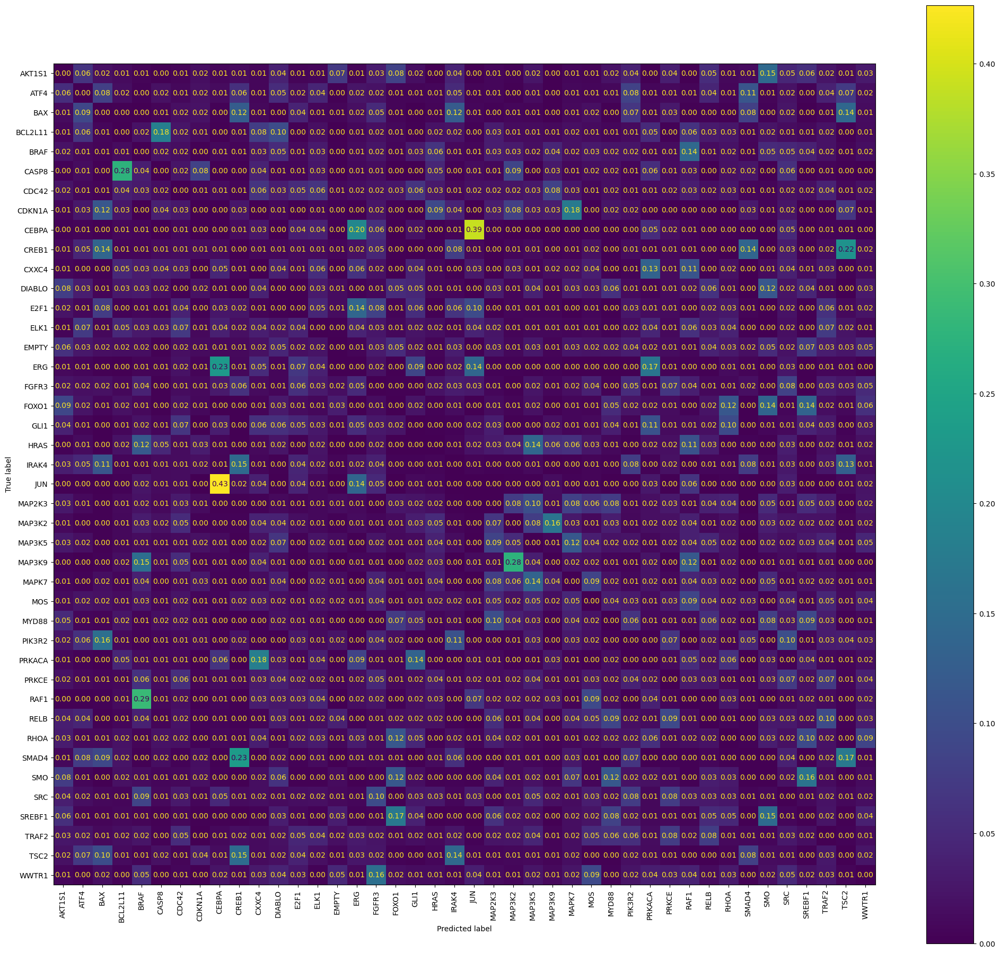

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [14]:
mpl.style.use("default")
fig, ax = plt.subplots(figsize=[25, 23])
cmd = ConfusionMatrixDisplay.from_predictions(
    loto_pred_df.loc[:, "labels"],
    loto_pred_df.loc[:, "prediction"],
    ax=ax,
    values_format=".2f",
    xticks_rotation="vertical",
    normalize="true",
)

---

Next, we will visualize the embeddings to this end, we will plot the image embeddings of the targets left out for each setting on top of the corresponding image embeddings of the test data.

In [ ]:
embs_dict = compute_physical_loto_space_embs(
    train_latents_dict, loto_latents_dict, random_state=1234, n_samples=50000
)

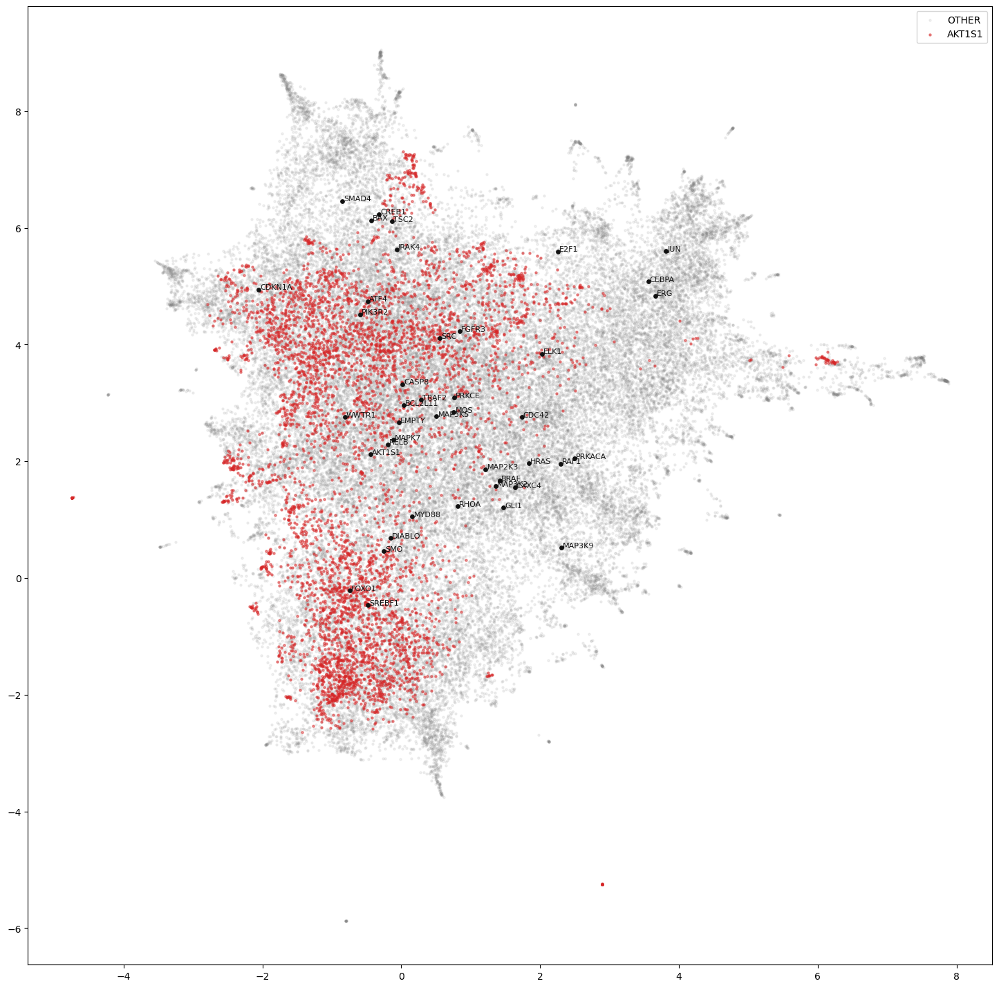

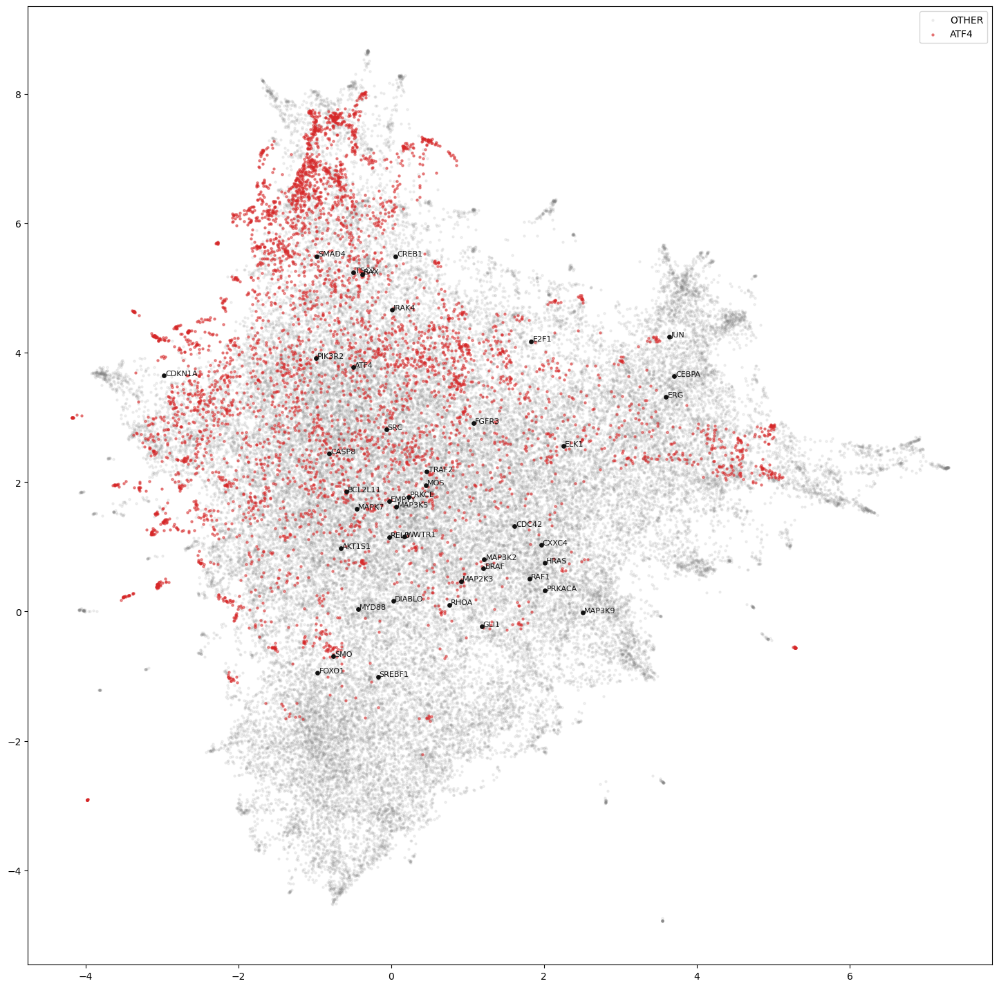

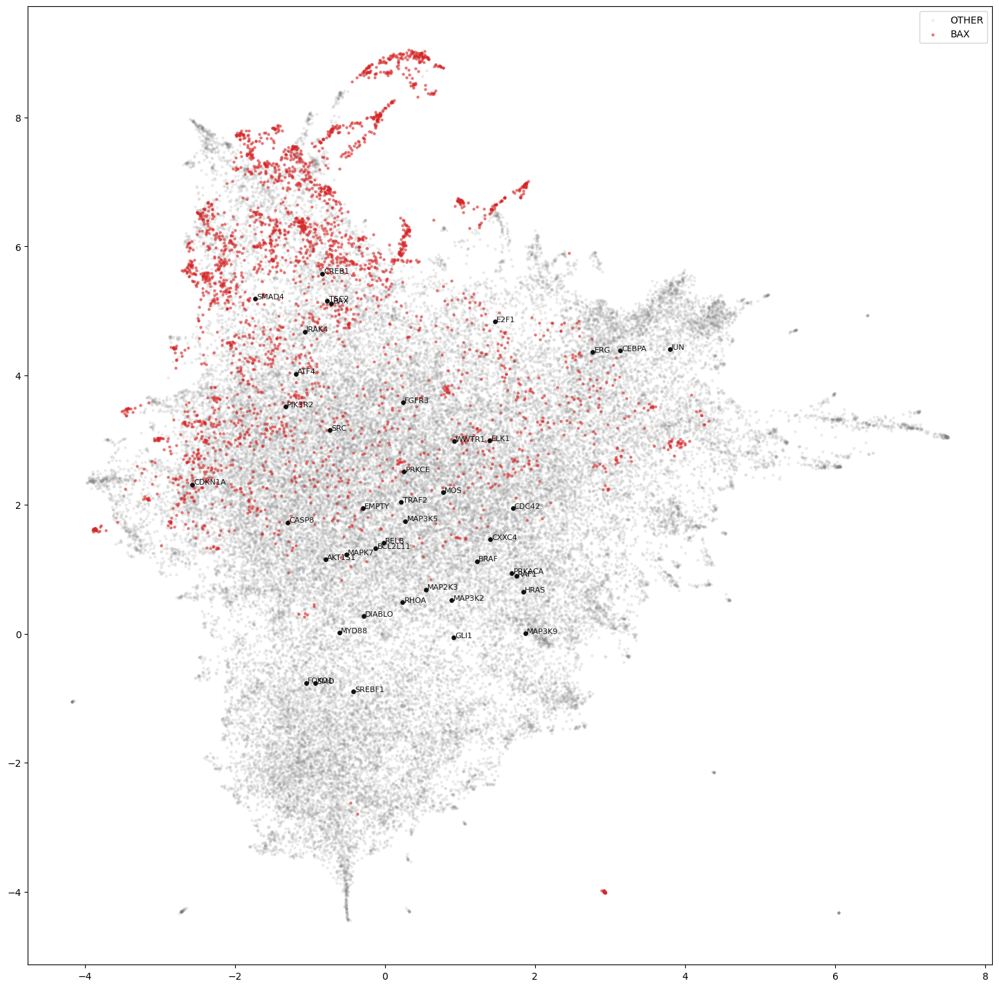

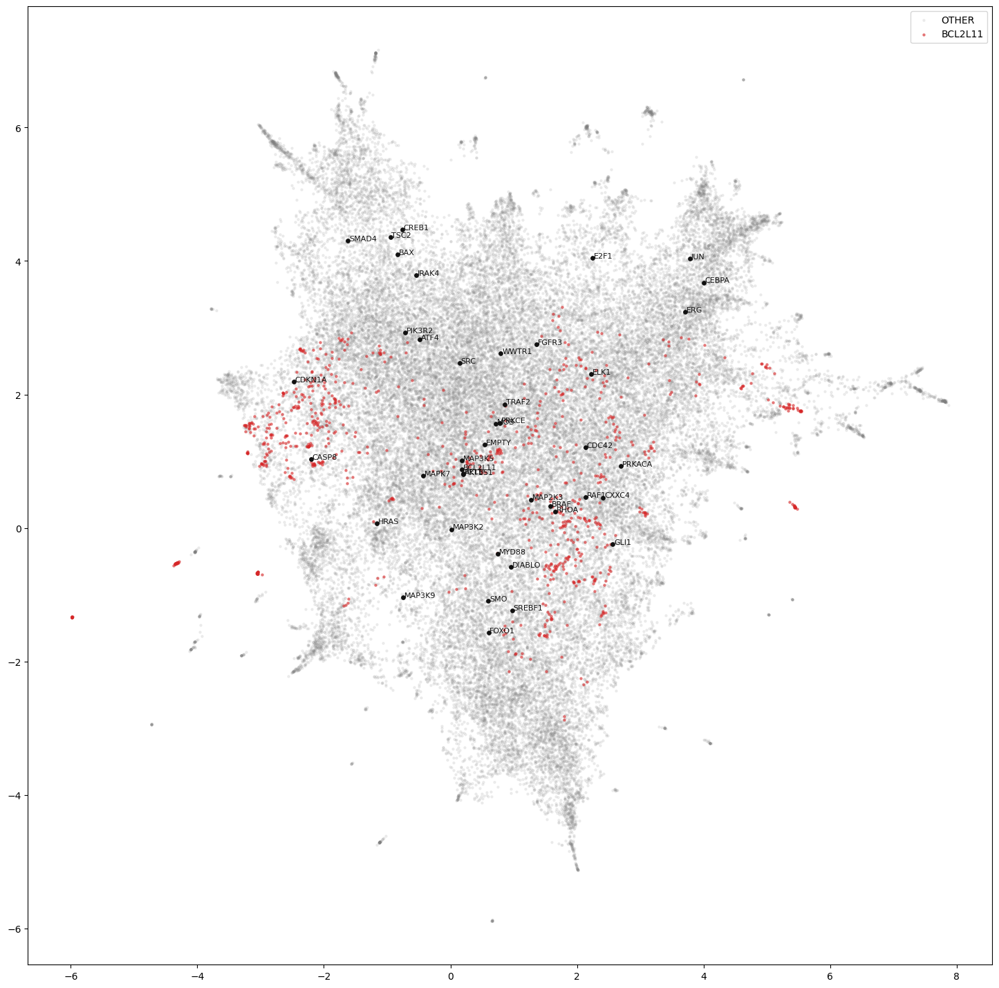

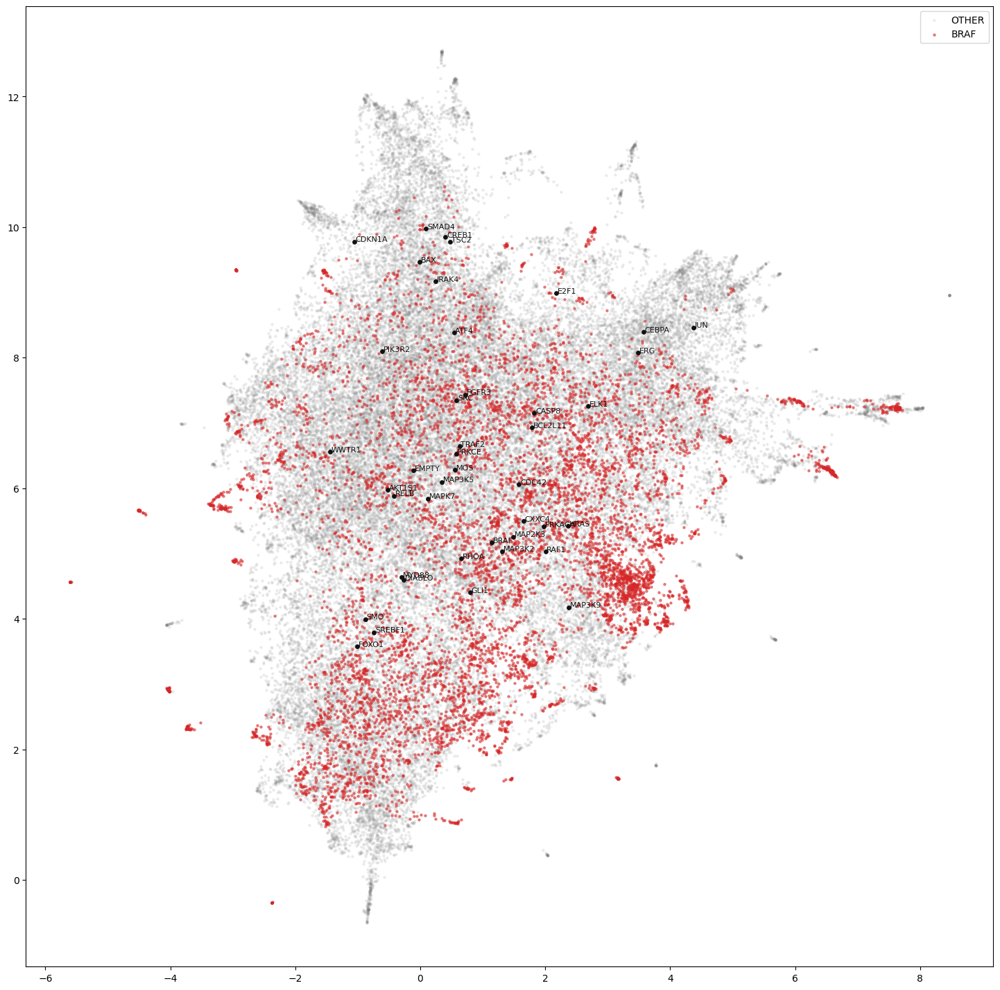

...

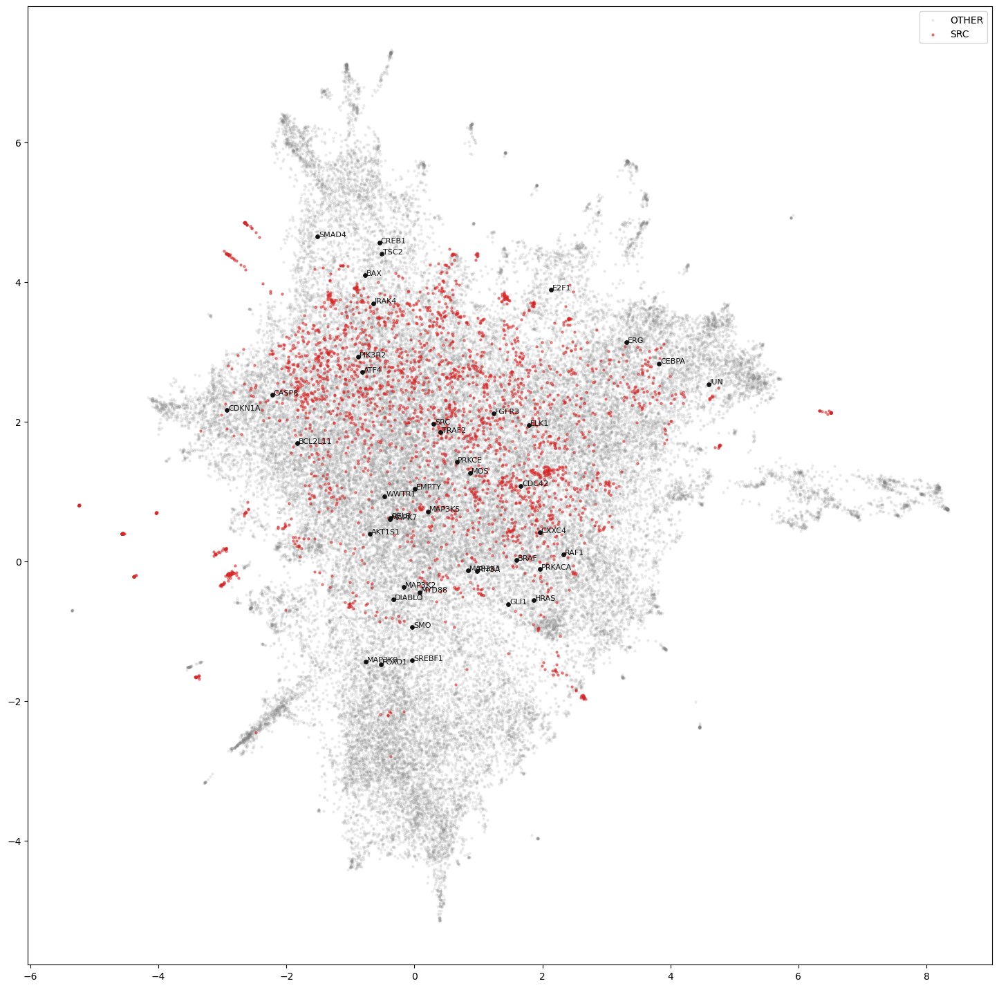

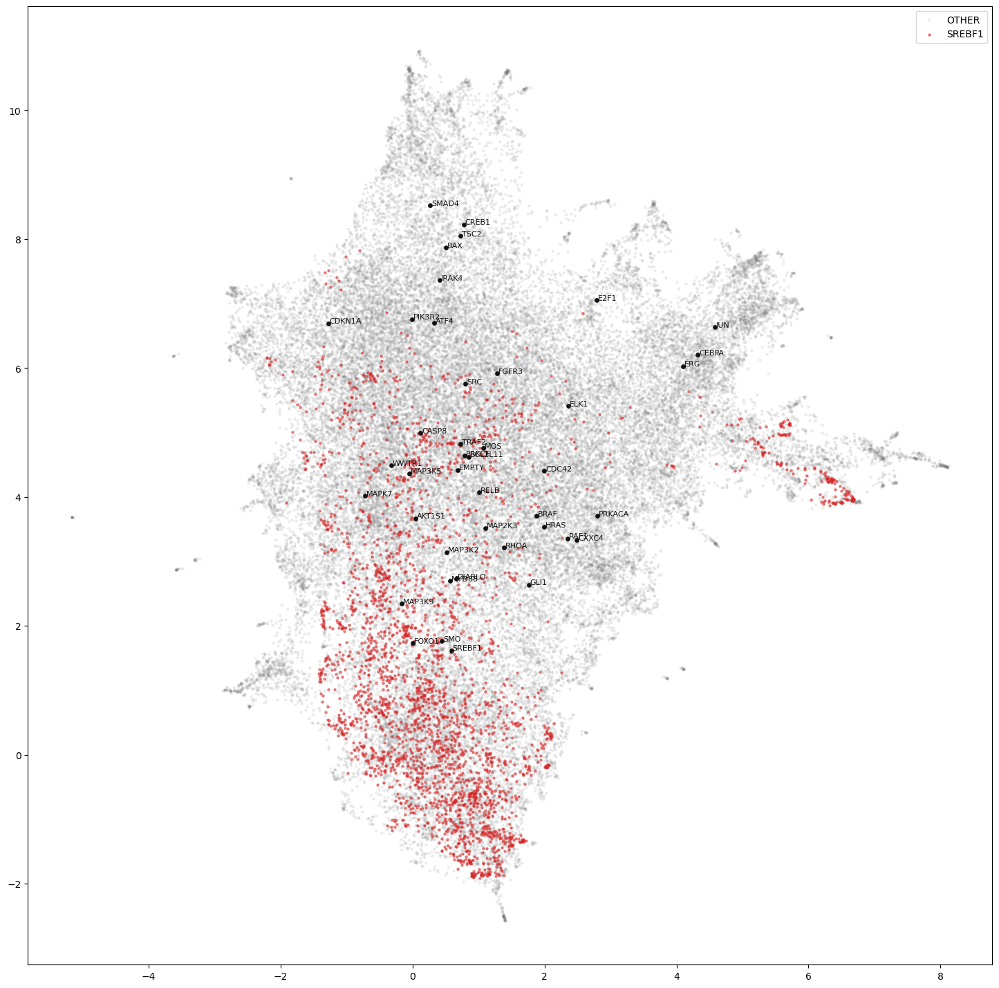

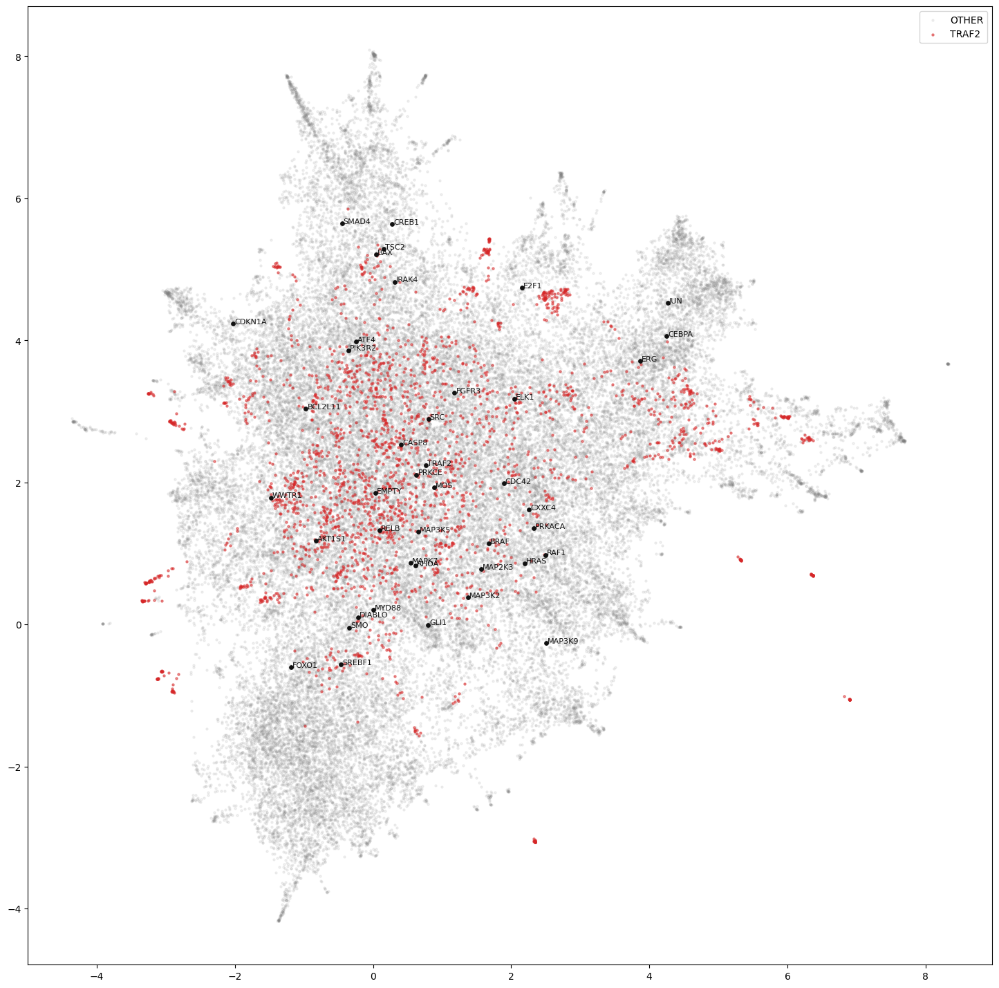

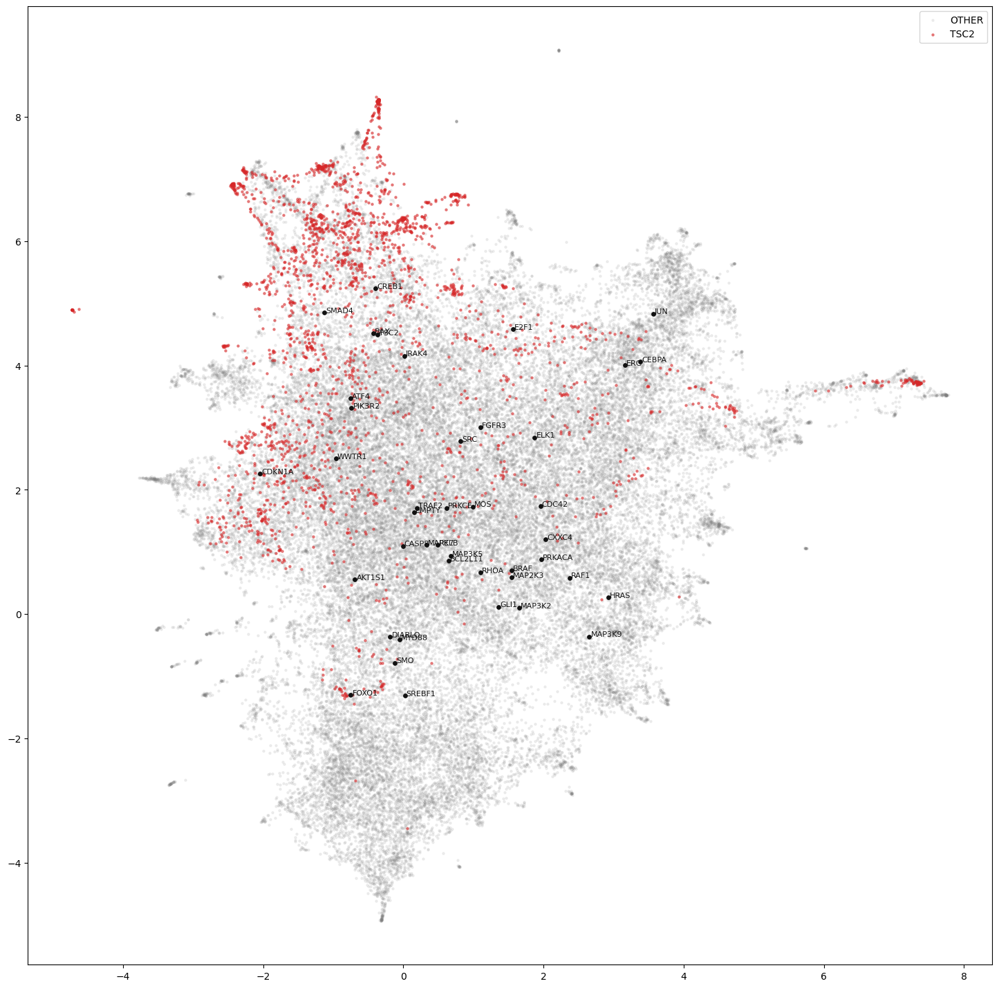

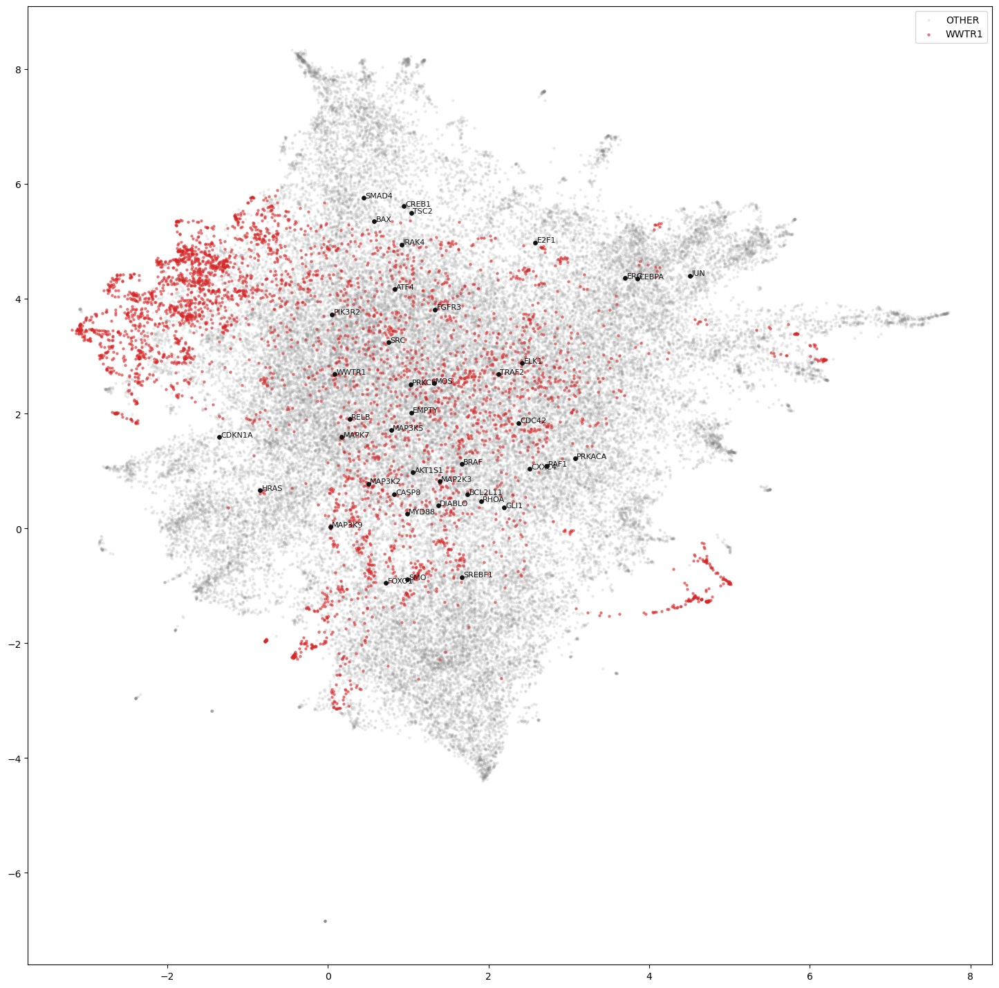

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [165]:
plot_physical_loto_spaces_embs(
    embs_dict,
    figsize=[18, 18],
    s=5,
    alpha=0.1,
    text_size=8,
    label_means=True,
)

---

## 3. Cluster analysis

Next, we assess the structure of the individual latent spaces, by clustering the mean embeddings for each target in the corresponding training set embeddings hierarchically using euclidean distance and complete linkage. We will compute the Calinski-Harabasz score for a number of clusters of 2-20.

AKT1S1


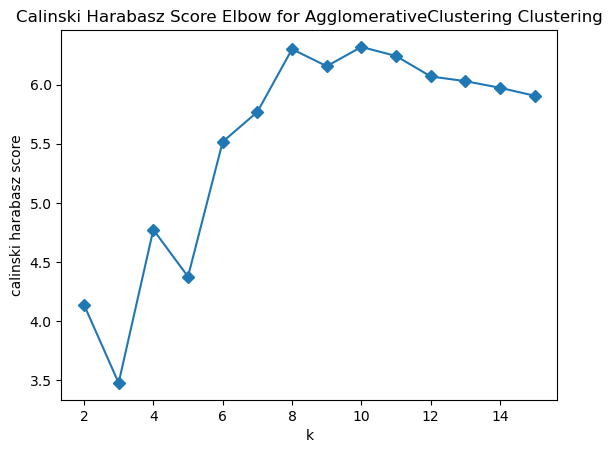

ATF4


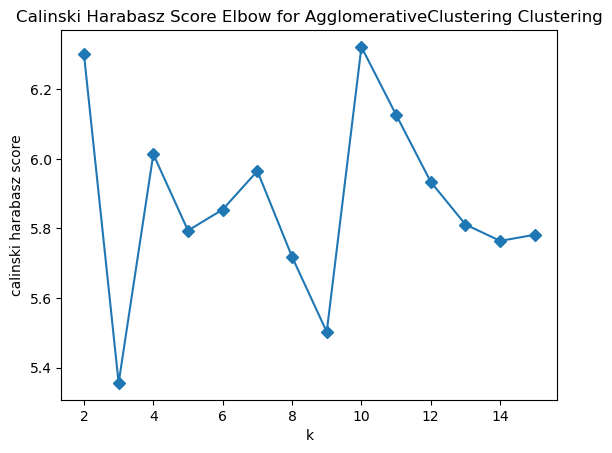

BAX


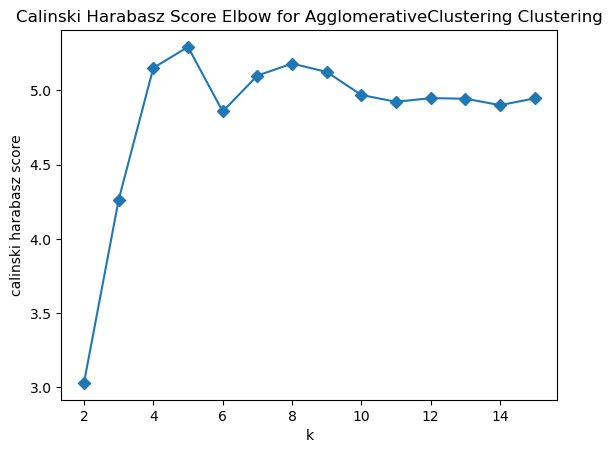

BCL2L11


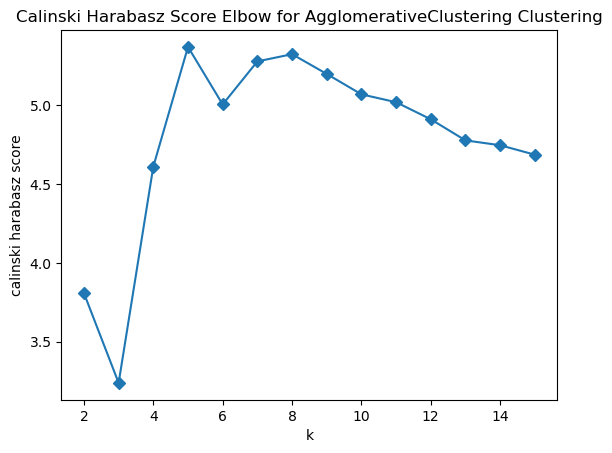

BRAF


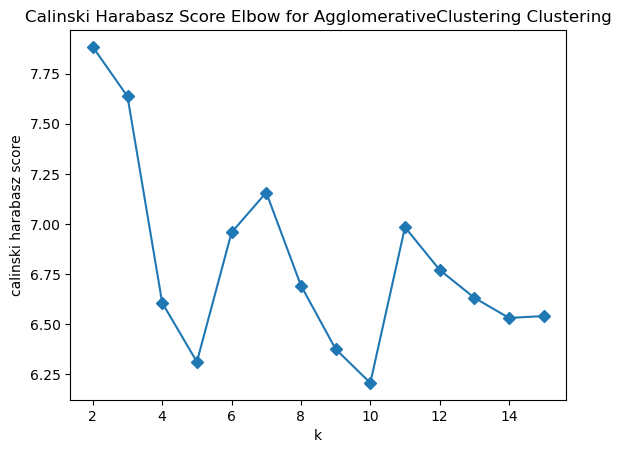

CASP8


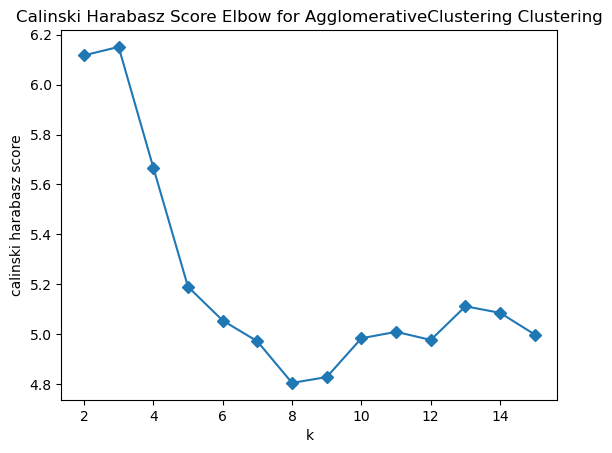

CDC42


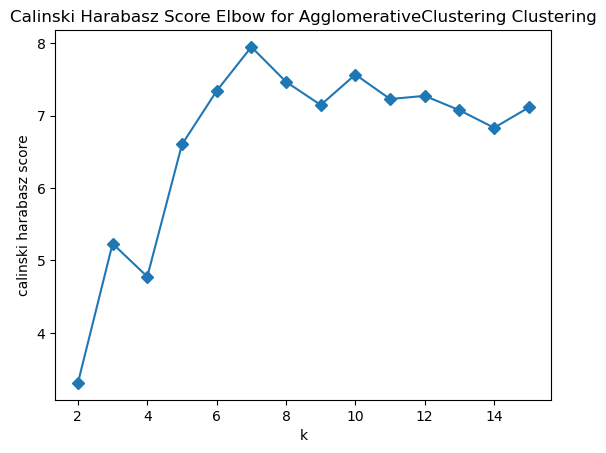

CDKN1A


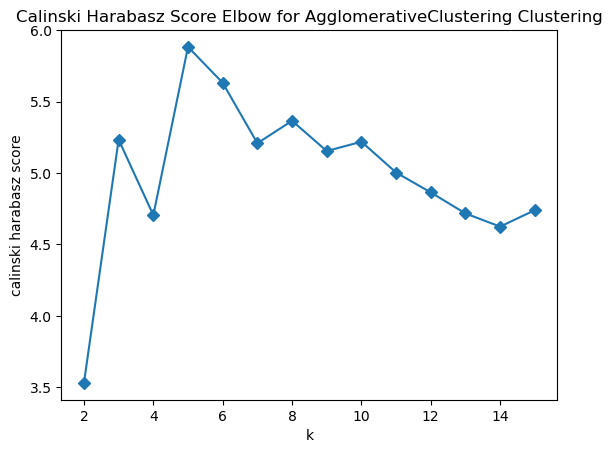

CEBPA


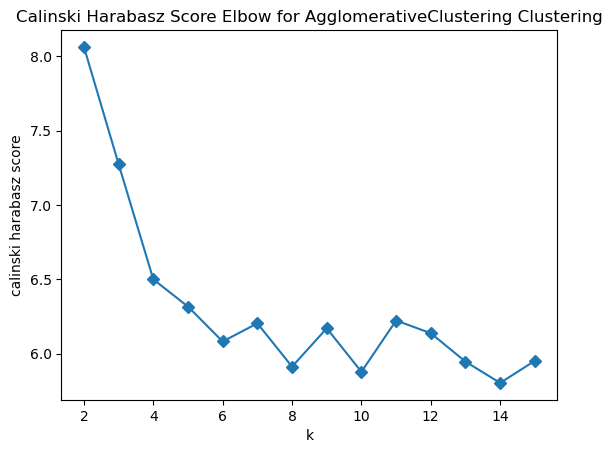

CREB1


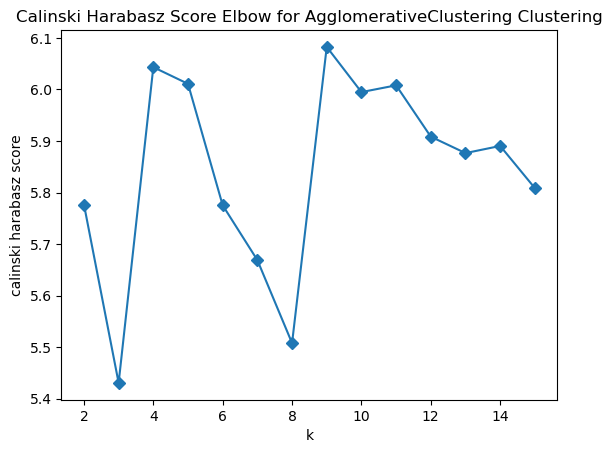

CXXC4


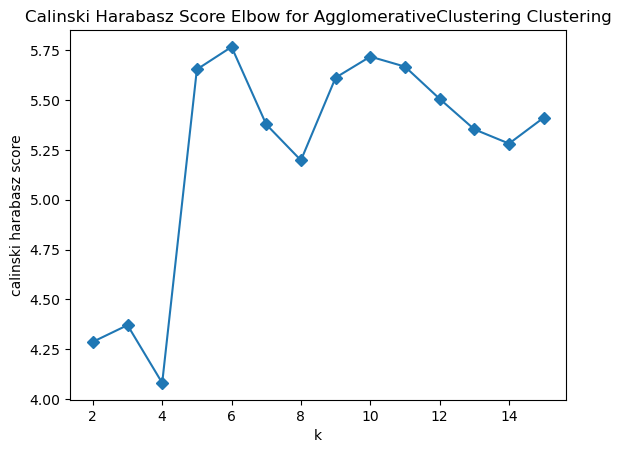

DIABLO


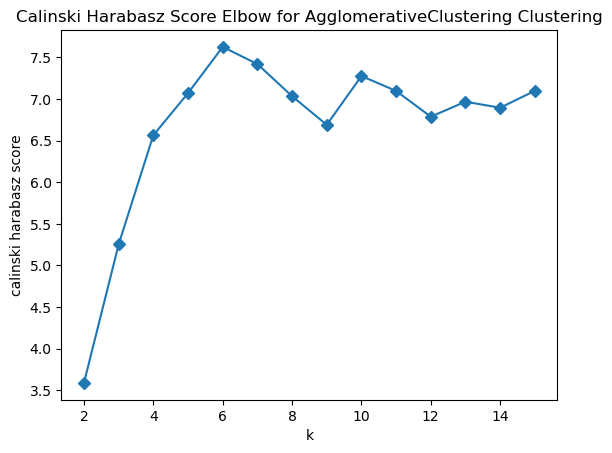

E2F1


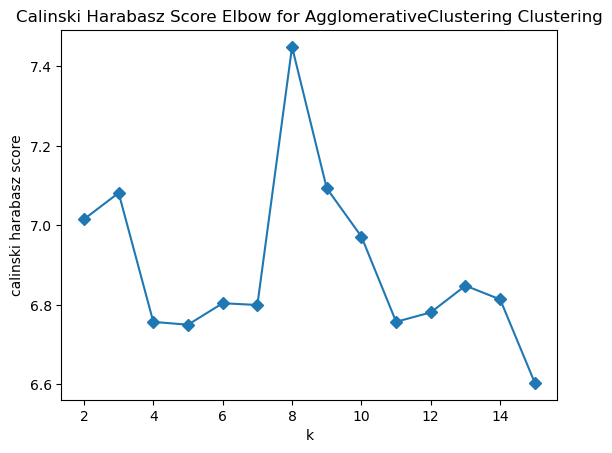

ELK1


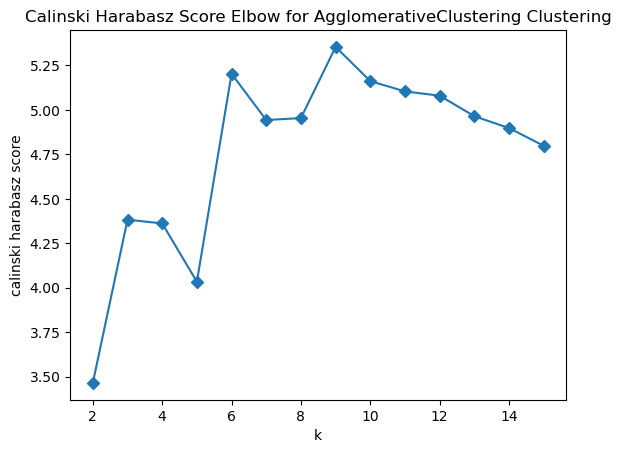

EMPTY


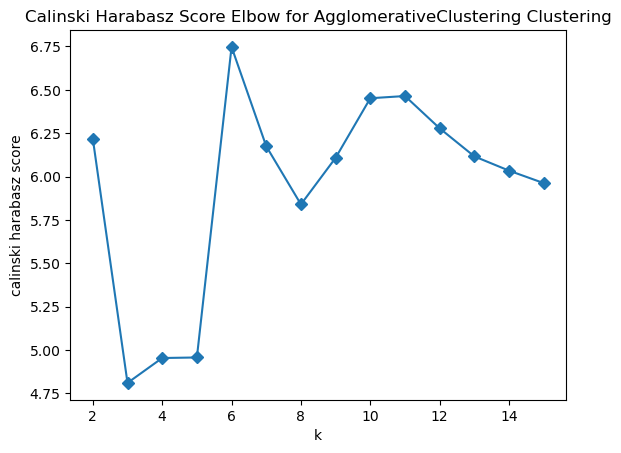

ERG


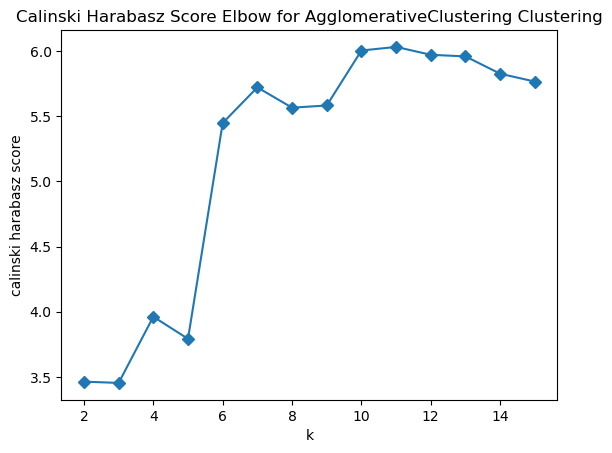

FGFR3


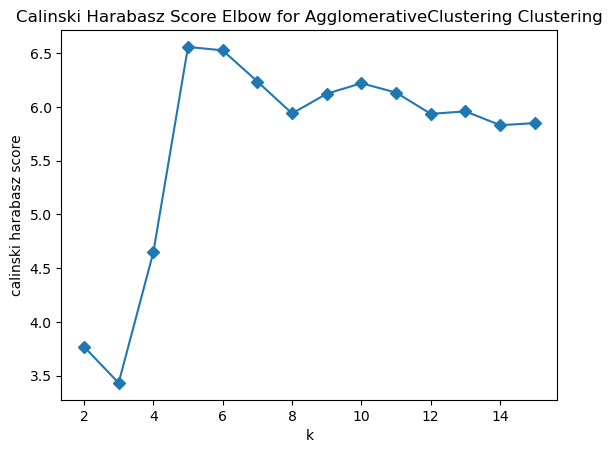

FOXO1


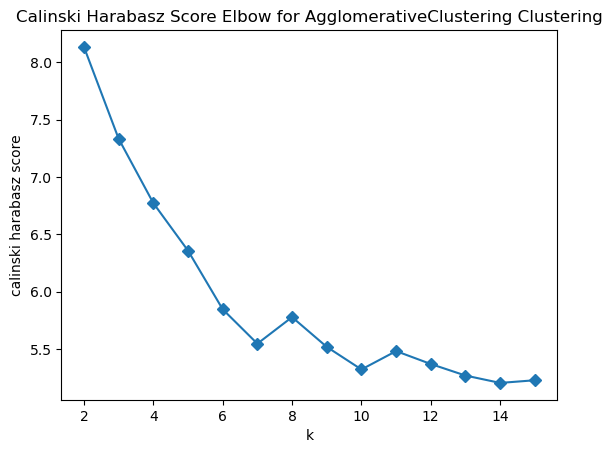

GLI1


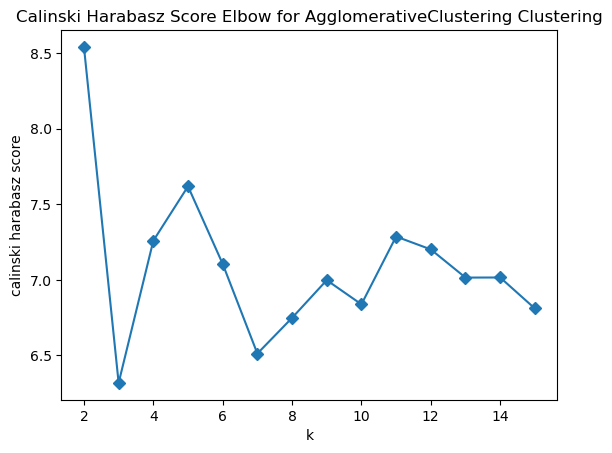

HRAS


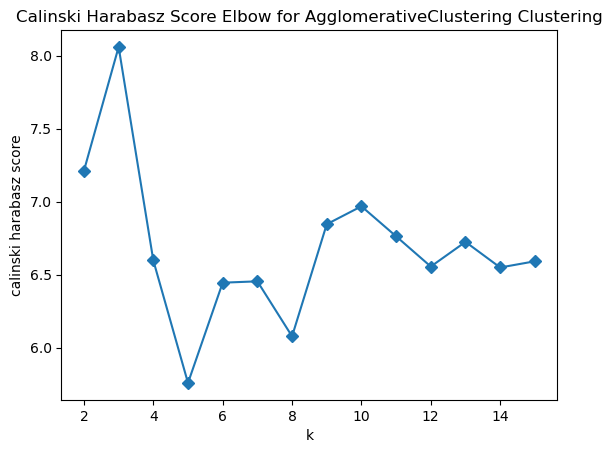

IRAK4


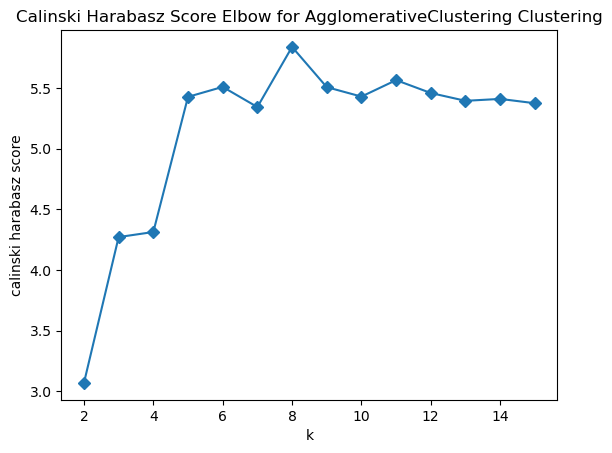

JUN


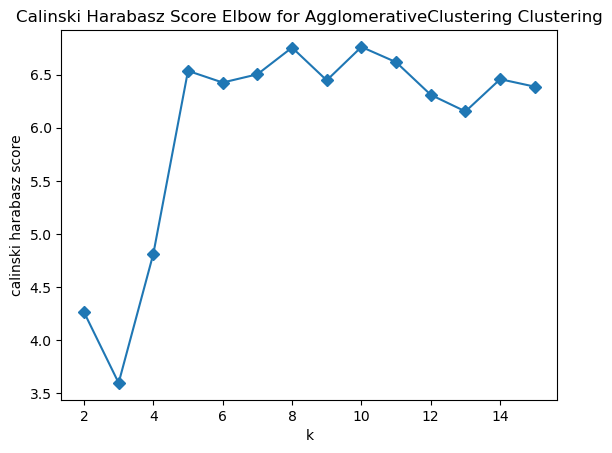

MAP2K3


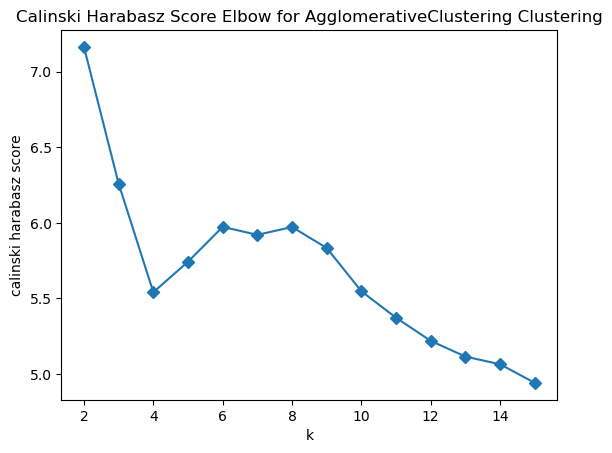

MAP3K2


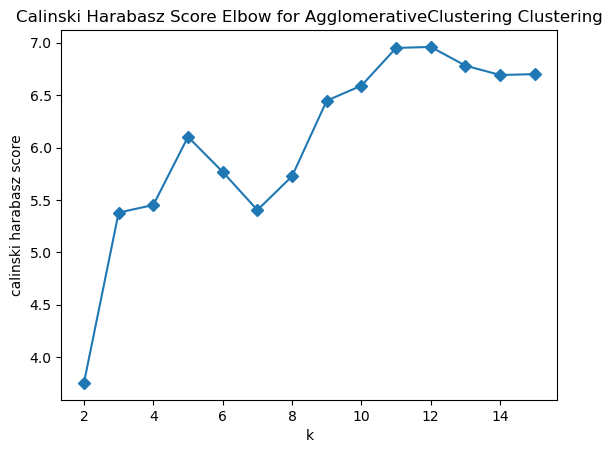

MAP3K5


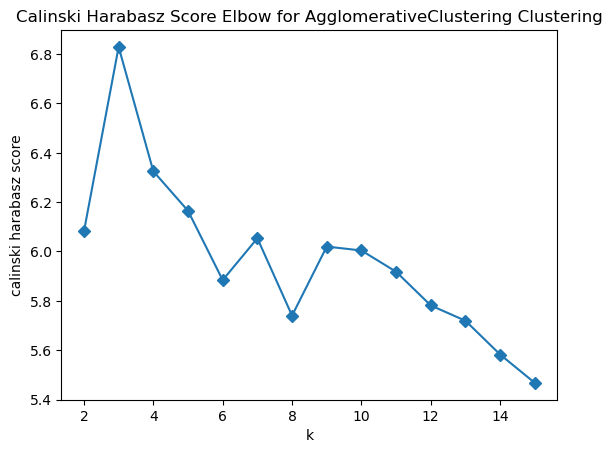

MAP3K9


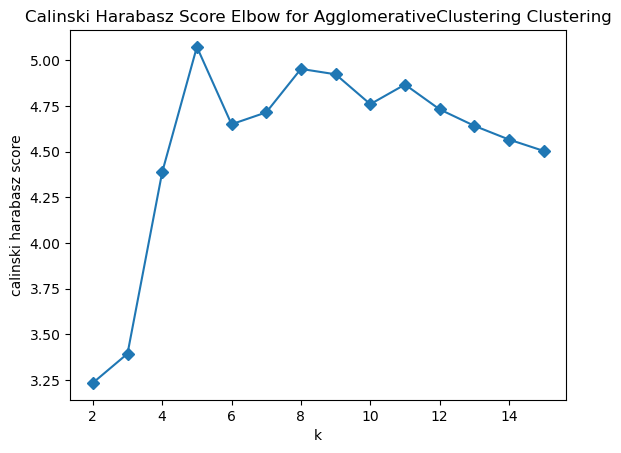

MAPK7


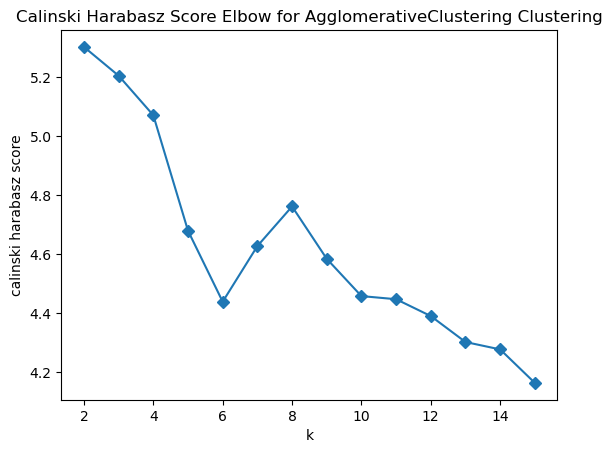

MOS


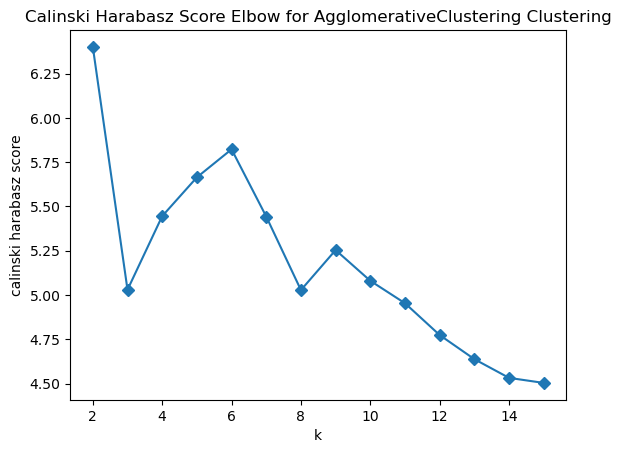

MYD88


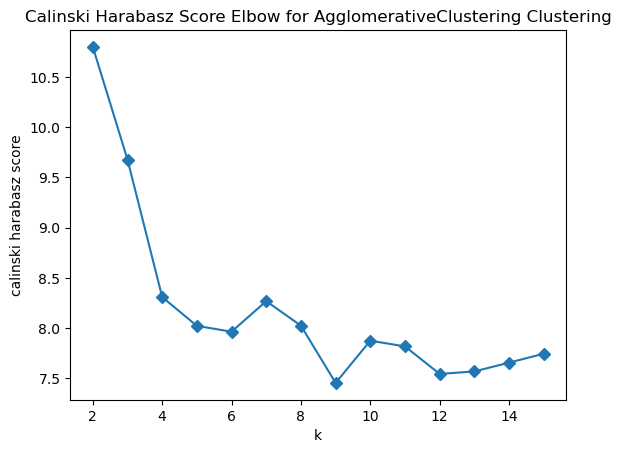

PIK3R2


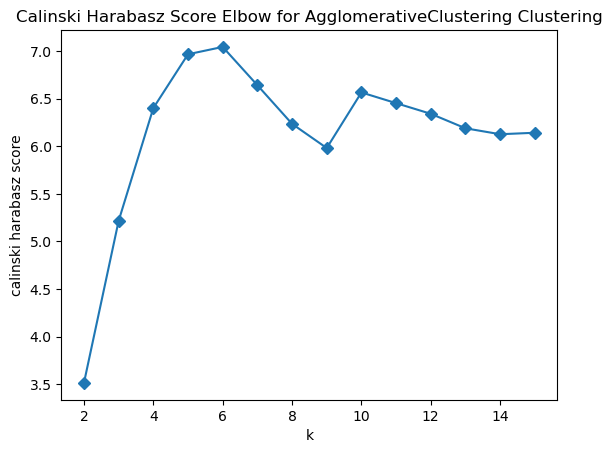

PRKACA


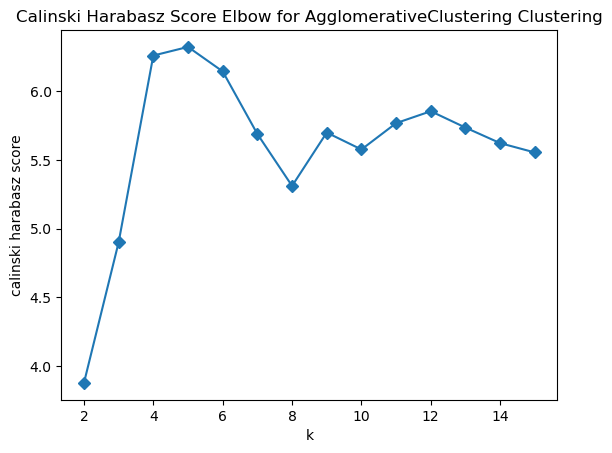

PRKCE


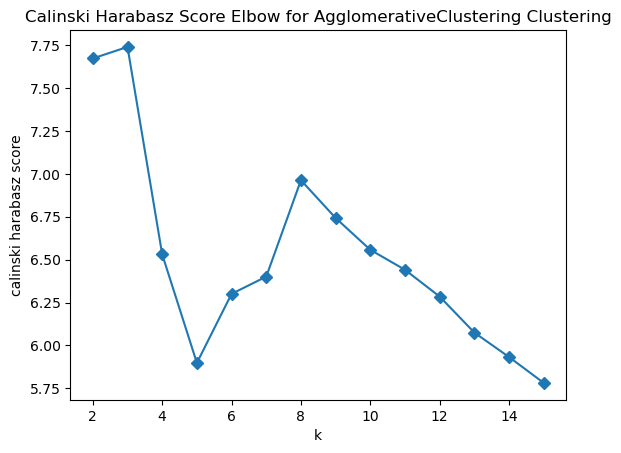

RAF1


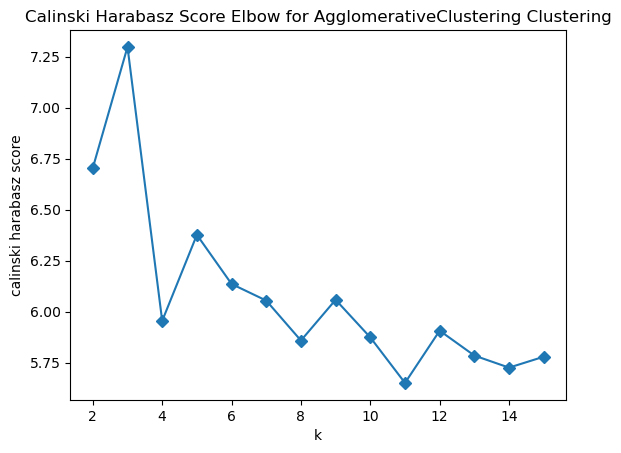

RELB


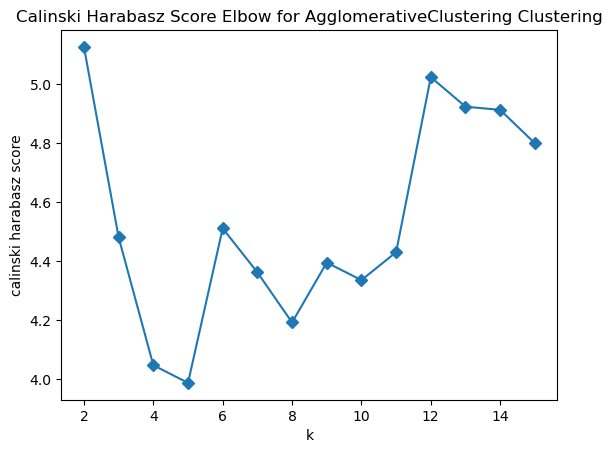

RHOA


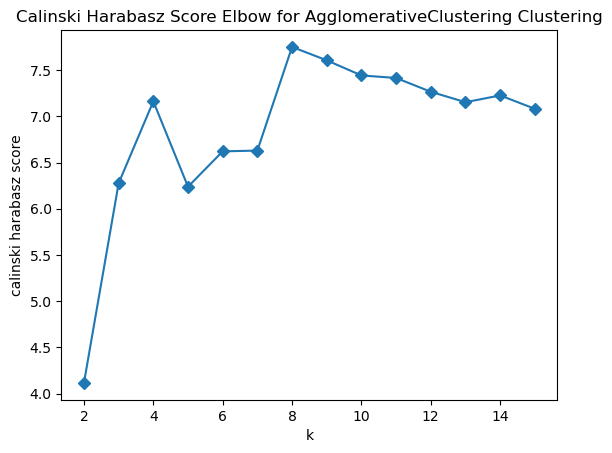

SMAD4


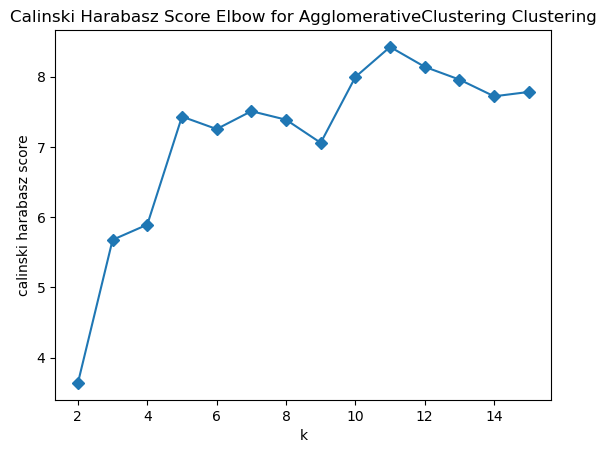

SMO


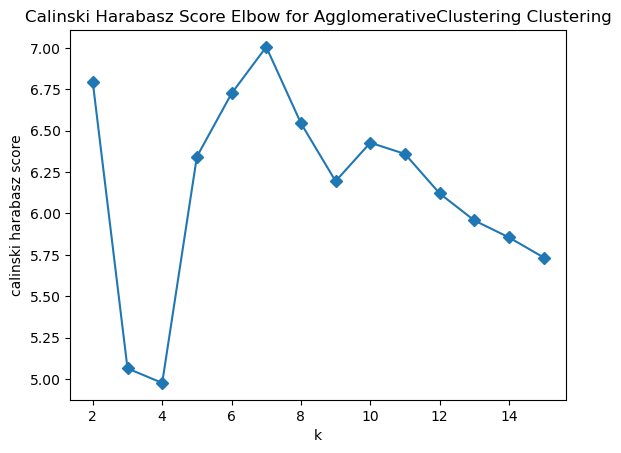

SRC


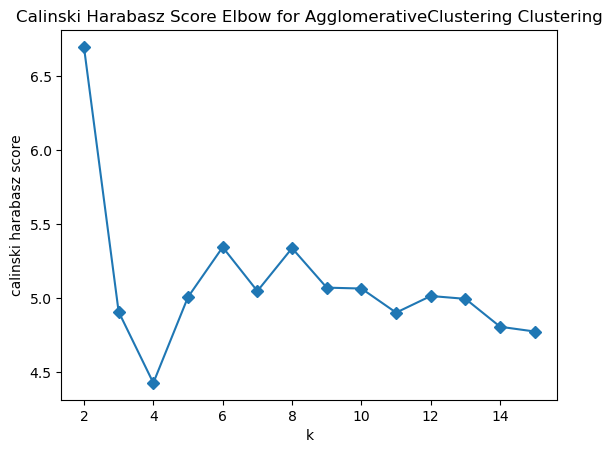

SREBF1


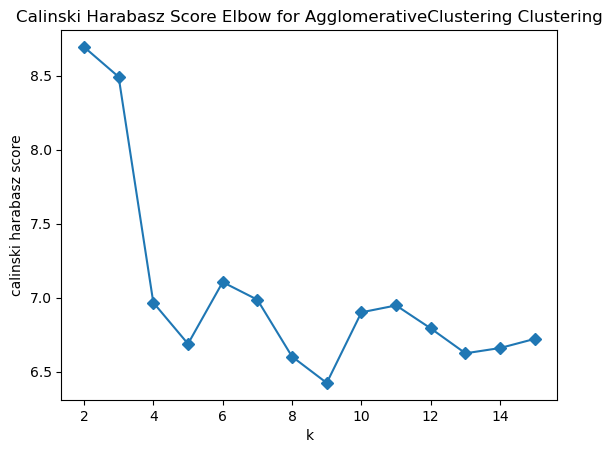

TRAF2


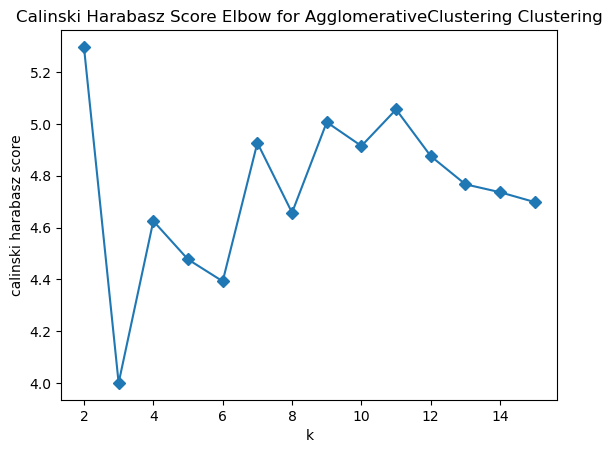

TSC2


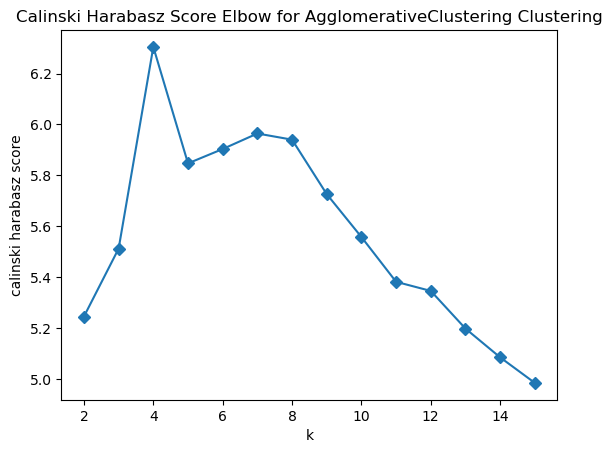

WWTR1


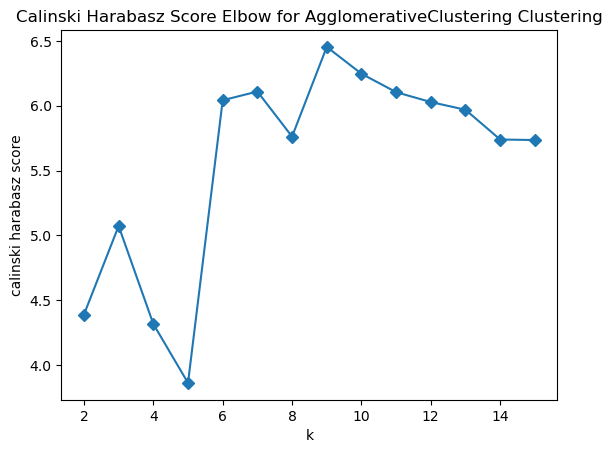

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [169]:
model = AgglomerativeClustering(affinity="euclidean", linkage="complete")
plot_calinski_harabasz_cluster_selection(model, train_latents_dict, max_clusters=15)

The above plots indicate a significant variability of the individually inferred latent spaces, which raises the question on whether or not one would like to use the same number of clusters for each training image embedding space or a variable number e.g. given by a local maxima of the Calinski-Harabasz score.

---

We initially decide for simplicity to divide each inferred physical space into 10 clusters by hierarchically clustering the mean embeddings of the respective perturbation distributions using euclidean distances and complete linkage. We thus derive for each training set image embedding space one cluster solution containing 10 clusters.

In [39]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
mean_clusters_dict = get_clusters_dict(train_latents_dict, model)

  0%|          | 0/42 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

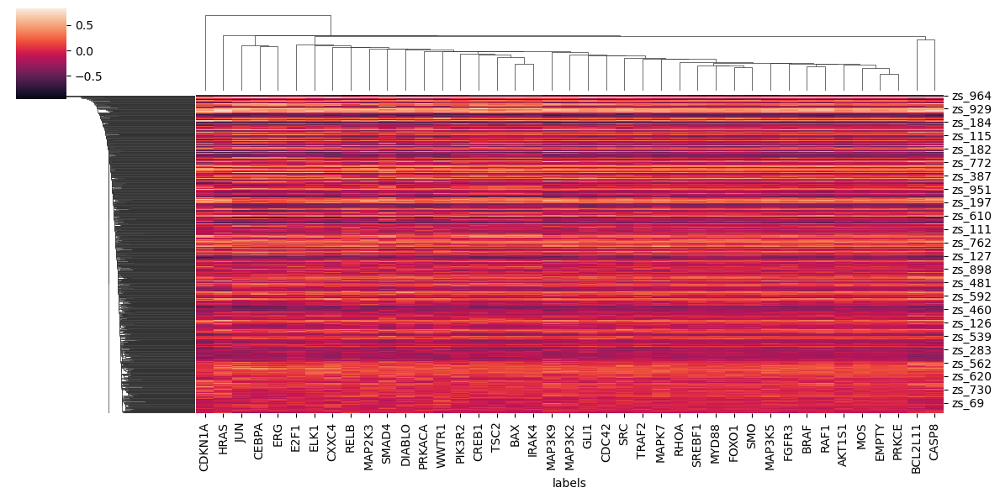

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [40]:
ax = sns.clustermap(
    train_latents_dict[""].groupby("labels").mean().transpose(),
    method="single",
    figsize=[12, 6],
)

To assess the variability of the inferred cluster structure, we will compute the adjusted mutual information for each pair of the 42 inferred physical spaces and their corresponding clusters. We will additionally compute the the p-values for non-random co-clustering using a permutation test.

In [197]:
cc_mi_perm_results = assess_co_clustering(mean_clusters_dict, score="mi", b=100)

  0%|          | 0/100 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [203]:
cc_ami_perm_results = assess_co_clustering(mean_clusters_dict, score="ami", b=100)

  0%|          | 0/100 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

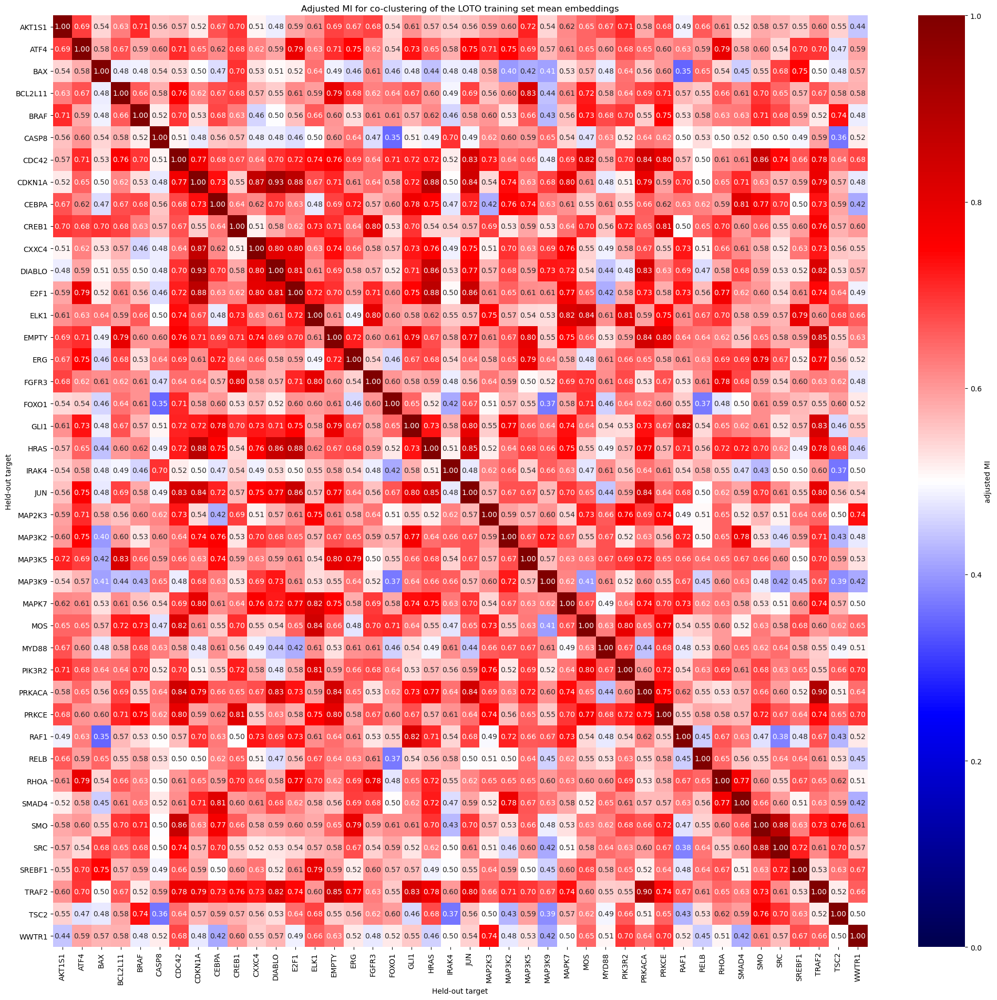

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [212]:
targets = cc_ami_perm_results["targets"]
cc_ami_score = pd.DataFrame(
    cc_ami_perm_results["cc_score"], index=targets, columns=targets
)
fig, ax = plt.subplots(figsize=[25, 23])
ax = sns.heatmap(
    cc_ami_score,
    cmap="seismic",
    annot=True,
    fmt=".2f",
    vmin=0,
    vmax=1,
    cbar_kws={"label": "adjusted MI"},
    ax=ax,
)
ax.set_xticklabels(targets, rotation=90)
ax.set_xlabel("Held-out target")
ax.set_ylabel("Held-out target")
ax.set_title("Adjusted MI for co-clustering of the LOTO training set mean embeddings")
plt.show()

Text(0.5, 1.0, 'Average adjusted MI of the co-clustering of the LOTO training embeddings')

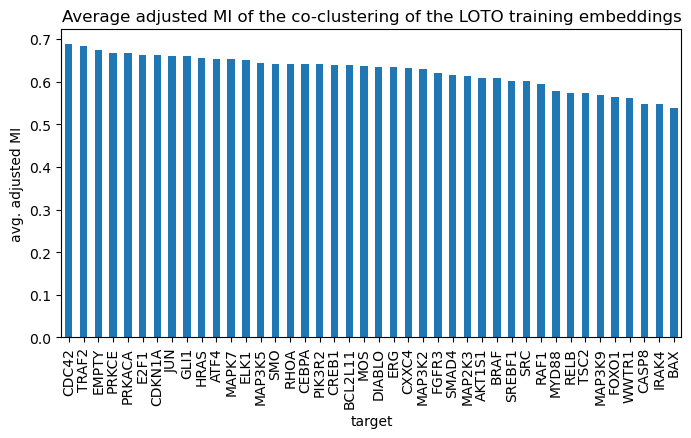

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [221]:
ax = (
    cc_ami_score.mean(axis=0)
    .sort_values(ascending=False)
    .plot(kind="bar", figsize=[8, 4])
)
ax.set_xlabel("target")
ax.set_ylabel("avg. adjusted MI")
ax.set_title("Average adjusted MI of the co-clustering of the LOTO training embeddings")

---

Finally, for debugging purposes we will also cluster the training latent space including the embeddings of the target that was left out during training.

In [9]:
model = AgglomerativeClustering(n_clusters=10, affinity="euclidean", linkage="complete")
full_latents_dict = {}
for k in train_latents_dict.keys():
    full_latents_dict[k] = pd.concat([train_latents_dict[k], loto_latents_dict[k]])
mean_full_clusters_dict = get_clusters_dict(full_latents_dict, model)

  0%|          | 0/42 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

---

## 4. Save data

We finally save the inferred cluster solutions as well as the the image embeddings for the training and test set as those will be later used to infer the regulatory space and/or the translational mapping.

In [16]:
output_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
targets = sorted(list(train_latents_dict.keys()))
for target in tqdm(targets):
    target_output_dir = os.path.join(output_dir, target)
    os.makedirs(target_output_dir, exist_ok=True)
    train_latents = train_latents_dict[target]
    train_latents.to_hdf(
        os.path.join(target_output_dir, "train_latents.h5"), key="data"
    )
    test_latents = test_latents_dict[target]
    test_latents.to_hdf(os.path.join(target_output_dir, "test_latents.h5"), key="data")
    loto_latents = loto_latents_dict[target]
    phy_embs = pd.concat([train_latents, loto_latents])
    phy_embs.to_hdf(os.path.join(target_output_dir, "phy_embs.h5"), key="data")
#     train_mean_clusters = mean_clusters_dict[target]
#     train_mean_clusters.to_csv(
#         os.path.join(target_output_dir, "train_phy_mean_clusters.csv")
#     )

  0%|          | 0/42 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

<IPython.core.display.Javascript object>

In [10]:
output_dir = (
    "../../../data/experiments/image_embeddings/specificity_target_emb_loto/embeddings"
)
targets = sorted(list(train_latents_dict.keys()))
for target in tqdm(targets):
    target_output_dir = os.path.join(output_dir, target)
    os.makedirs(target_output_dir, exist_ok=True)
    mean_full_clusters = mean_full_clusters_dict[target]
    mean_full_clusters.to_csv(
        os.path.join(target_output_dir, "phy_mean_full_clusters.csv")
    )

  0%|          | 0/42 [00:00<?, ?it/s]

<IPython.core.display.Javascript object>

We will also for fun 